In [1]:
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image, ImageFilter

import plotly.graph_objects as go

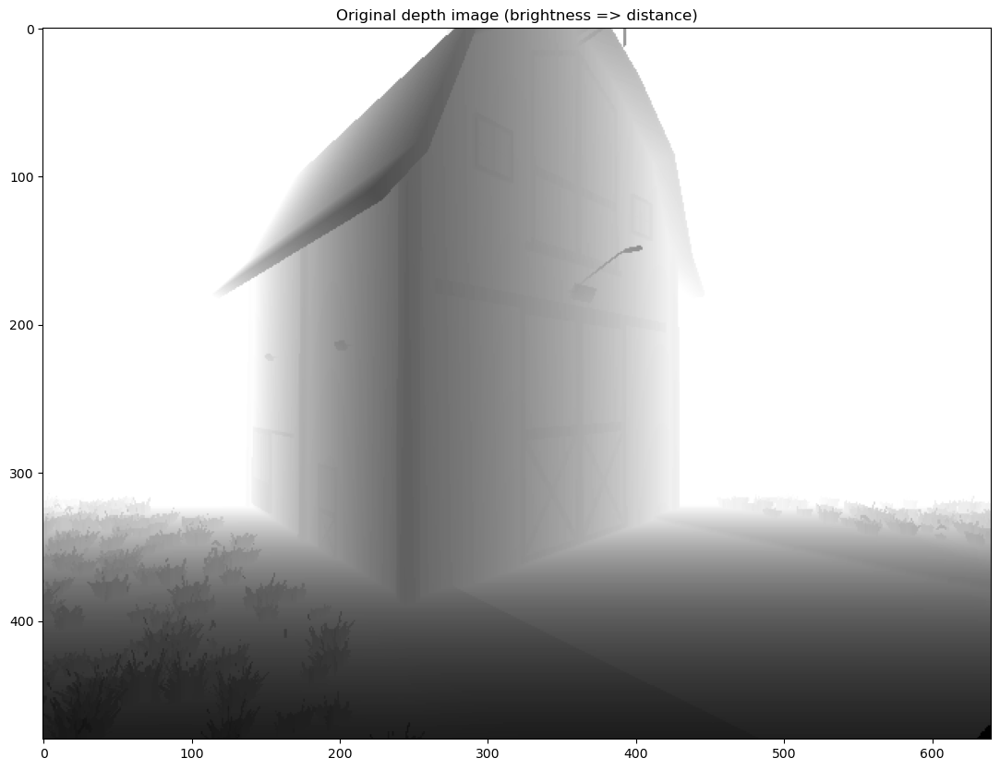

In [2]:
# Original depth image captured from CARLA (max distance 19m)
img = Image.open("imgs/sim_depth.png")

plt.figure(figsize=(15,10))
plt.imshow(img, cmap='gray')
plt.title("Original depth image (brightness => distance)")
plt.show()

In [3]:
img.size

(640, 480)

In [4]:
img_ratio = img.size[0]/img.size[1]
img_ratio

1.3333333333333333

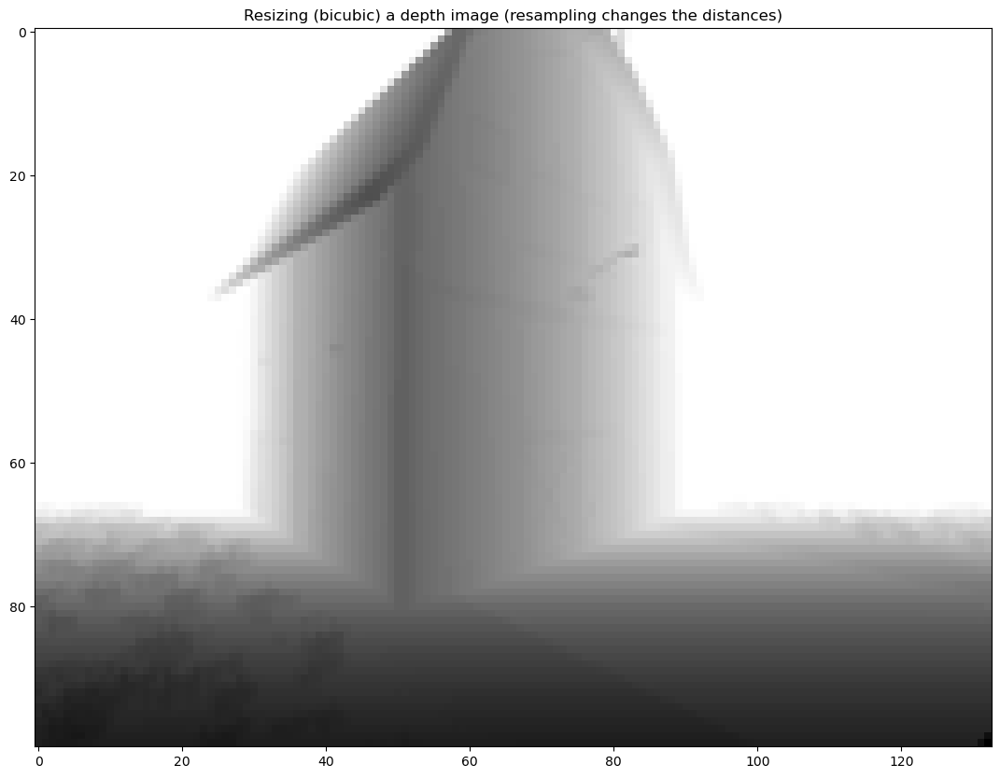

In [5]:
# This is an example of what happens when you simply try to resize
# a depth image as if it was a "normal" image: 
# - the original distances (depth) will change!

MIN_SIZE = 100
plt.figure(figsize=(15,10))
plt.imshow(img.resize((round(img_ratio*MIN_SIZE),MIN_SIZE), resample=Image.BICUBIC), cmap='gray')
plt.title("Resizing (bicubic) a depth image (resampling changes the distances)")
plt.show()

In [6]:
img_array = np.array(img)

MAX_DIST = 19 # The values were filtered
MIN_RES = 1 # [m]
DEPTH_DILATION = 0.5 # [m]

# DEPTH_DILATION will reduce the depth by this amount because the path planning 
# considers the robot as a point, so this is needed to avoid collisions as the
# drone is NOT a point.
img_in_meters = MAX_DIST*(img_array/255.0)-DEPTH_DILATION

img_in_meters = (img_in_meters/MIN_RES).round()*MIN_RES

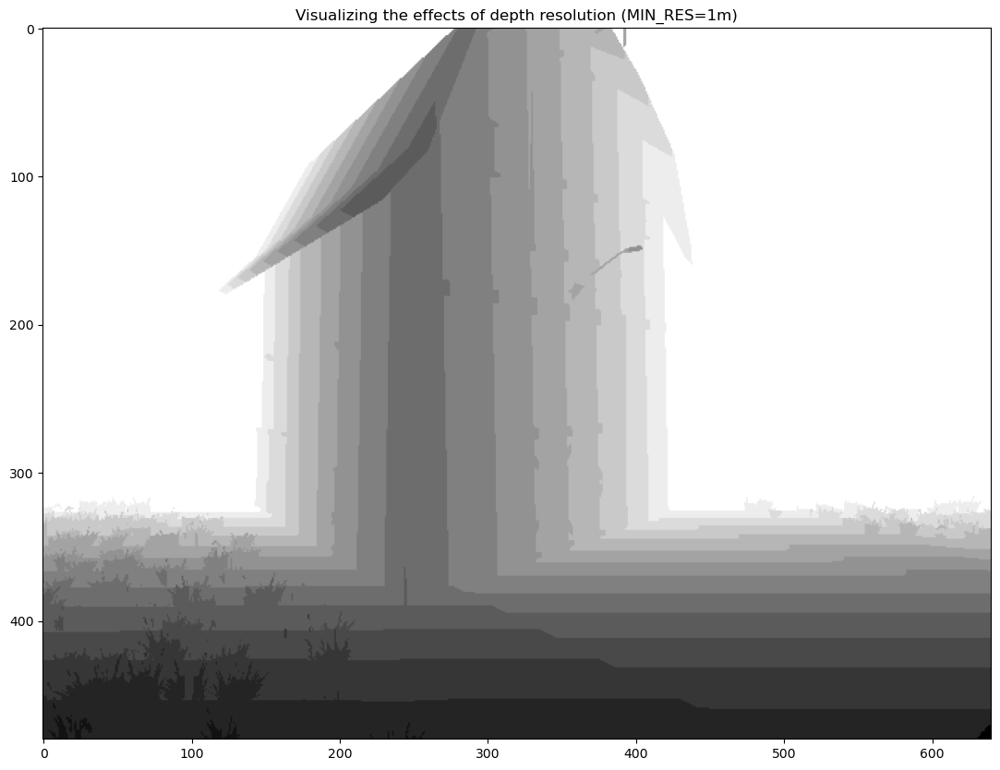

In [7]:
plt.figure(figsize=(15,10))
plt.imshow(img_in_meters, cmap='gray')
plt.title(f"Visualizing the effects of depth resolution (MIN_RES={MIN_RES}m)")
plt.show()

In [8]:
%%time

# To avoid the problems with the previous resized depth image, the code below
# will resize each individual depth value to keep them consistent with the original data
# while distorsions will happen to the shapes (XY) on those layers.

MIN_SIZE = 100
GAP4DIFFUSION = 2

img_ratio = img_in_meters.shape[1]/img_in_meters.shape[0]
NEW_SIZE = MIN_SIZE, round(MIN_SIZE*img_ratio) # HEIGHT,WIDTH

DETAIL_LEVEL = 255
OLD_SIZE = img_in_meters.shape

new_image = np.ones(NEW_SIZE)*MAX_DIST

for i,z in enumerate(np.arange(MAX_DIST,0,-MIN_RES)):
    tmp = np.ones(OLD_SIZE,dtype='uint8')*255
    if i > GAP4DIFFUSION:
        tmp[abs(img_in_meters-z)<MIN_RES] = 0
    
    tmp_img = Image.fromarray(tmp).resize((NEW_SIZE[1],NEW_SIZE[0]),resample=Image.BICUBIC)
    
    # Here the blurring filter works like a dilatation
    # because of the next filtering using the DETAIL_LEVEL
    # Increasing the blur will help avoiding "leakage"
    tmp_img_blurred = tmp_img.filter(ImageFilter.GaussianBlur(MIN_RES*2))
    # To avoid collisions this blurring should be in meters. Also, it should
    # be dependent of the depth instead of a fixed value for all depths.
    # Maybe, to speed things up, we may find a fixed value that is guaranteed 
    # to avoid collisions: using the closest depth layer to calculate it.
    
    new_slice = np.array(tmp_img_blurred)
    
    # The result of the BICUBIC down sampling will be usually thicker than we would like.
    # Reducing the value of DETAIL_LEVEL will ignore the lightest values.
    # To keep obstacles as thin as possible it would need better filtering here
    new_image[new_slice<DETAIL_LEVEL]=z

CPU times: user 40.7 ms, sys: 1.95 ms, total: 42.6 ms
Wall time: 41.8 ms


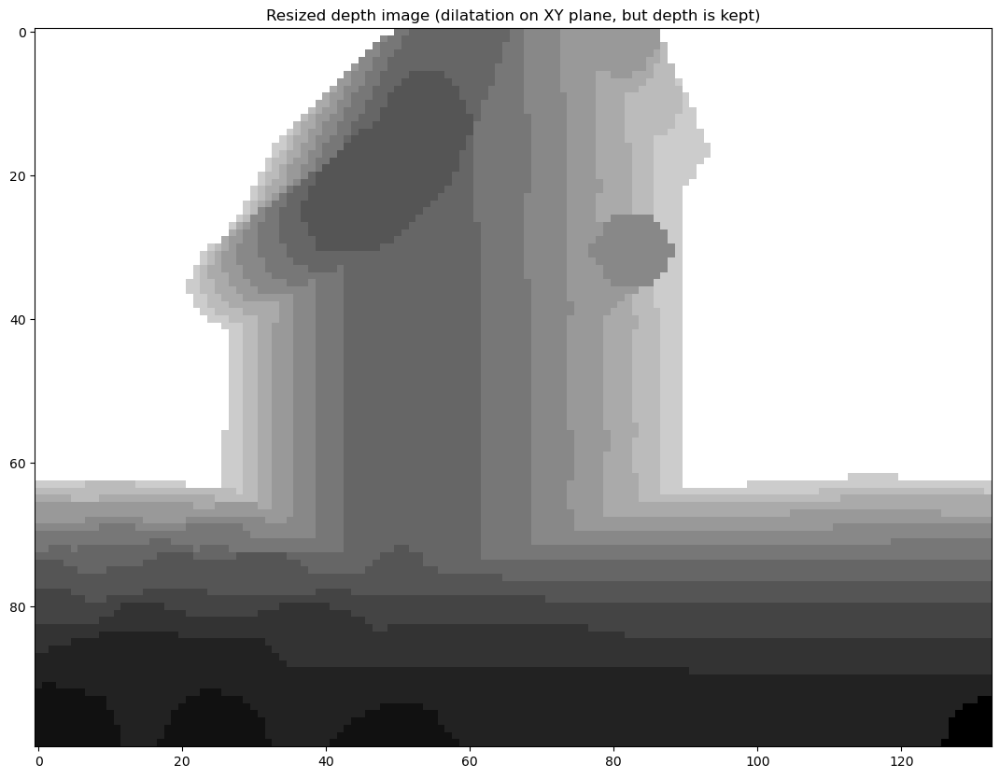

In [9]:
plt.figure(figsize=(15,10))
plt.imshow(new_image, cmap='gray')
plt.title("Resized depth image (dilatation on XY plane, but depth is kept)")
plt.show()

In [10]:
# Generate the data needed for the 3D visualization

X, Y, Z = np.mgrid[0:new_image.shape[1], 
                   0:new_image.shape[0], 
                   0:round(MAX_DIST/MIN_RES)]

depth_x = []
depth_y = []
depth_z = []
depth_intensities = []
for n,(i,j,k) in enumerate(zip(X.flatten(),Y.flatten(),Z.flatten())):
    d = new_image[j,i]
    if d/MIN_RES==k:
        depth_x.append(i)
        depth_y.append(j)
        depth_z.append(d)
        depth_intensities.append(0)

In [11]:
depth = go.Scatter3d(
    x=depth_x,
    y=depth_y,
    z=depth_z,
    mode='markers',
    marker=dict(
        size=5,
        color=depth_intensities,     # set color to an array/list of desired values
        colorscale='Gray',     # choose a colorscale
        showscale=True,
        opacity=1,
        symbol='circle',
        #cmax=10,
        #cmin=0
    ),
    showlegend=False
)
fig = go.Figure(data=[depth])
# tight layout
camera = dict(
    up=dict(x=0, y=-1, z=0),
    #eye=dict(x=0, y=0, z=-2),
    #eye=dict(x=2, y=0, z=0),
    eye=dict(x=1.5, y=0, z=-1.5),
)
fig.update_layout(
    scene_camera=camera)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), width=800, height=600)
# https://stackoverflow.com/a/70238553/7658422
fig.update_layout(
    scene={
        'xaxis': {'autorange': True}, 
        'yaxis': {'autorange': True}, 
        'zaxis': {'range': (0,MAX_DIST)},
    }
)

fig.update_layout(scene_aspectmode='cube')
# fig.update_layout(scene2_aspectmode='manual',
#                   scene2_aspectratio=dict(x=1, y=1, z=2))
fig.show()

In [ ]:
import taichi as ti
import time

MAX_DEPTH_PATH = round(MAX_DIST/MIN_RES)

ti.reset()
# ti.init(arch=ti.gpu, advanced_optimization=True, debug=False) # Using GPU (CUDA)
# https://github.com/taichi-dev/taichi/blob/master/taichi/program/compile_config.h
ti.init(arch=ti.cpu, cpu_max_num_threads=5, advanced_optimization=True, debug=False) # Using CPU

# once a kernel is launched, or any field is accessed, it's not possible to
# create new fields without resetting...
u = ti.field(ti.float64, (*NEW_SIZE, MAX_DEPTH_PATH)) # final gradient
r = ti.field(ti.float64, (*NEW_SIZE, MAX_DEPTH_PATH)) # current iteration
b = ti.field(ti.float64, (*NEW_SIZE, MAX_DEPTH_PATH)) # boundary conditions
d = ti.field(int, NEW_SIZE) # depth image

@ti.func
def next_value(alpha, i, j, k):
    A = u[i+1,j  ,k]
    B = u[i-1,j  ,k]
    C = u[i  ,j+1,k]
    D = u[i  ,j-1,k]
    E = u[i  ,j  ,k+1]
    F = u[i  ,j  ,k-1]
    G = u[i  ,j  ,k]
    N = b[i,j,k] # Neumann boundary = 0
    # N will act as a switch, turning ON/OFF the Neumann boundary according to 
    # the obstacles in the depth image (b)
    return alpha*((A+B+C+D+E+F-6*G)*N + (2*A+2*C+2*E-6*G)*(1-N)) + G

@ti.kernel
def init_boundaries():
    b.fill(1)
    for i in range(NEW_SIZE[0]):
        for j in range(NEW_SIZE[1]):
            for k in range(d[i,j],MAX_DEPTH_PATH-GAP4DIFFUSION):
                b[i,j,k] = 0

@ti.kernel
def goal_plane(value: ti.float64, k: int):
    for i in range(NEW_SIZE[0]):
        for j in range(NEW_SIZE[1]):
            u[i,j,k] = value
@ti.kernel
def diffusion(alpha: ti.float32):
    # ti.static makes it a compile-time thing
    # This will allow the compiler to unroll, optimize, etc
    for i in range(1,NEW_SIZE[0]-1):
        for j in range(1,NEW_SIZE[1]-1):
            for k in range(1,MAX_DEPTH_PATH-1):
                r[i,j,k] = next_value(alpha, i, j, k)

    for i in range(NEW_SIZE[0]):
        for j in range(NEW_SIZE[1]):
            for k in range(MAX_DEPTH_PATH):
                u[i,j,k] = r[i,j,k]*b[i,j,k]

[Taichi] version 1.7.3, llvm 15.0.4, commit 5ec301be, linux, python 3.11.6


[I 02/17/25 17:12:43.364 340628] [shell.py:_shell_pop_print@23] Graphical python shell detected, using wrapped sys.stdout


[Taichi] Starting on arch=x64


In [13]:
# First call to force kernel compilation...
goal_pos = 0,0,0

alpha = 0.15
total_iterations = 3000

init_t = time.monotonic()
r.fill(0.0)
u.fill(0.0)

d.from_numpy((new_image/MIN_RES).round().astype('int32'))

init_boundaries()

u[goal_pos] = 1E3 # boundary conditions

goal_plane(1E3, MAX_DEPTH_PATH-2)

diffusion(alpha)

In [14]:
USE_GOAL_PLANE = False
MIN_GRAD = 1E-6
MIN_CHANGE = 1E-12
TOTAL_ITERATIONS = 6000

# The Z coordinate here is not the REAL Z, but the index.
# Its value changes according to MIN_RES.

# This position is used to stop the diffusion when the minimum value is achieved
curr_pos = NEW_SIZE[1]//2,NEW_SIZE[0]//2,1

# The goal will always be at the centre of the image, but Z=98 (Z=99 is boundary)
# goal_pos = NEW_SIZE[0]//2,NEW_SIZE[1]//2,MAX_DEPTH_PATH-2
goal_pos = 50, 65, MAX_DEPTH_PATH-2 # Y,X,Z

alpha = 0.15

init_t = time.monotonic()
r.fill(0.0)
u.fill(0.0)

# u[curr_pos] = 0

d.from_numpy((new_image/MIN_RES).round().astype('int32'))

init_boundaries()
if USE_GOAL_PLANE:
    goal_plane(1E6, goal_pos[2])
else:
    u[goal_pos] = 1E6 # source

past_values = [1.0]*1000
for i in range(TOTAL_ITERATIONS):
    diffusion(alpha)
    past_values.pop()
    past_values.insert(0,u[curr_pos])
    if USE_GOAL_PLANE:
        goal_plane(1E6, goal_pos[2])
    else:
        u[goal_pos] = 1E6 # source
    if u[curr_pos]>MIN_GRAD:
        print(f'Minimum gradient achieved at iteration #{i}!')
        break
    if abs(sum(past_values)/len(past_values)-u[curr_pos])<MIN_CHANGE:
        print(f'Convergence achieved at iteration #{i}!')
        break
    
ud = u.to_numpy()
print(f"Total processing time: {time.monotonic()-init_t}")

Convergence achieved at iteration #999!
Total processing time: 1.8679660130292177


In [15]:
ud[curr_pos], curr_pos

(3.218013845129254e-17, (66, 50, 1))

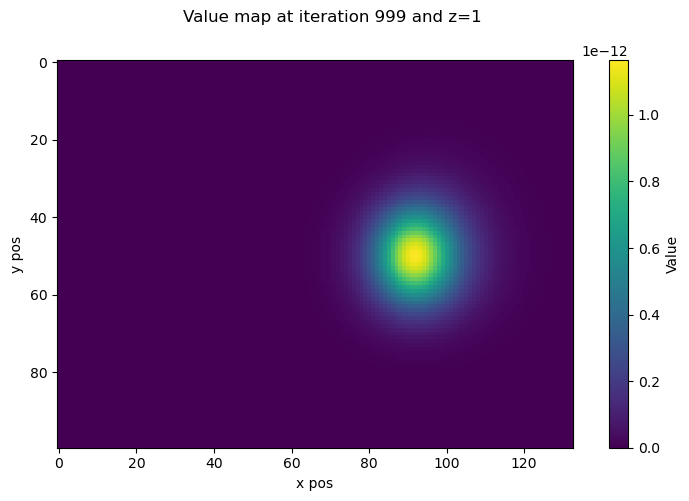

In [16]:
import matplotlib.pyplot as plt

# %matplotlib notebook

z = 1

fig, ax = plt.subplots(figsize=(8,5))
mappable = ax.imshow(ud[...,z], interpolation=None, vmin=ud[...,z].min(), 
                                                    vmax=ud[...,z].max())#, cmap=plt.cm.jet)

# Visualize the obstacles projected to the back plane
# mappable = ax.imshow(b.to_numpy().sum(axis=2), interpolation=None, cmap='gray')

fig.colorbar(mappable, label="Value")
ax.set_xlabel("x pos")
ax.set_ylabel("y pos")
fig.suptitle(f"Value map at iteration {i} and z={z}")
fig.tight_layout()
# ax.invert_xaxis()
plt.show()

In [17]:
from scipy.misc import derivative
from scipy.interpolate import LinearNDInterpolator, NearestNDInterpolator

# prediction = np.log(np.swapaxes(ud,0,1)+1E-12) # the gradient is using x,y as numpy array image
prediction = np.swapaxes(ud,0,1) # the gradient is using x,y as numpy array image


# This cell only needs to be executed once per prediction
grad_x, grad_y, grad_z = np.gradient(prediction, edge_order=1)

def func3D(X):
    return prediction[round(X[0]),round(X[1]),round(X[2])]

def part_derivative3D(func3D,x,y,z,dx=1,dy=1,dz=1):
    d1 = grad_x[round(x), round(y), round(z)]
    d2 = grad_y[round(x), round(y), round(z)]
    d3 = grad_z[round(x), round(y), round(z)]
    return np.array([d1,d2,d3])

def gradient_descent3D(func3D, start, min_val, tolerance, learn_rate=0.1, n_iter=50):
    vector = [np.array(start)]
    try:
        for i in range(n_iter):
            prev_val = func3D(vector[-1])
            grad = part_derivative3D(func3D,vector[-1][0],vector[-1][1],vector[-1][2])
            diff = -learn_rate * grad/np.linalg.norm(grad)
            if np.isnan(diff).any():
                print(f"[{i}] nanananananan")
                return np.array(vector)
            vector.append(vector[-1]+diff)
            if abs(func3D(vector[-1])-min_val)<tolerance:
                print("break!")
                break
            if i % 50 ==0:
                print(func3D(vector[-1]), vector[-1])
    except Exception as e:
        print(f"Error:{e}")
    finally:
        return np.array(vector)

In [18]:
position = [60,90,5]

print(f"Initial gradient: {part_derivative3D(func3D,position[0],position[1],position[2],dx=1,dy=1,dz=1)}")

steps = gradient_descent3D(func3D, position, prediction.max(), abs(prediction.max()*0.001),
                           -2, n_iter=100)

x_list, y_list, z_list = steps.T

z_list *= MIN_RES

print(f"Final position: {steps[-1]}")

Initial gradient: [ 2.98021486e-19 -7.51186228e-19 -1.05604525e-18]
3.645296142144352e-18 [60.44822494 88.87021433  3.41170572]
break!
Final position: [65.41536104 50.47544721 17.32015221]


In [19]:
def approx_world_coord(X, d, focal_x=432.4551801426587, 
                             focal_y=432.4551801426587, 
                             cx=60, cy=50):
    # x_over_z and y_over_z are adimensional (px/px)
    # d is in m, therefore z, x and y are in m
    # focal_x and focal_y are in px, therefore we need
    # to adjust to the original size or x and y_over_z
    # will have the wrong values
    x,y = X.T
    x_over_z = ORIGINAL_SIZE_X*(cx - x) / focal_x
    y_over_z = ORIGINAL_SIZE_Y*(cy - y) / focal_y
    z = d / np.sqrt(1. + x_over_z**2 + y_over_z**2)
    x = x_over_z * z
    y = y_over_z * z
    return np.array([x, y, z]).T

In [20]:
depth = go.Scatter3d(
    x=depth_x,
    y=depth_y,
    z=depth_z,
    name="frame",
    mode='markers',
    marker=dict(
        size=5,
        color=depth_intensities,     # set color to an array/list of desired values
        colorscale='Gray',     # choose a colorscale
        showscale=True,
        opacity=1,
        symbol='circle',
        #cmax=10,
        #cmin=0
    ),
    showlegend=False
)

path_markers = []
path_lines = []
for i in range(1,len(x_list)):
    path_marker = go.Scatter3d(
        x=x_list[:i],
        y=y_list[:i],
        z=z_list[:i],
        mode='markers',
        marker=dict(color='red', size=5),
        showlegend=False
    )
    path_markers.append(path_marker)

    path_line = go.Scatter3d(
        x=x_list[:i],
        y=y_list[:i],
        z=z_list[:i],
        mode='lines',
        line=dict(color='red', width=5),
        showlegend=False
    )
    path_lines.append(path_line)


frames = []
for i,(pm,pl) in enumerate(zip(path_markers,path_lines)):
    frames.append(go.Frame(data=[pm,pl],name=str(i)))

fig = go.Figure(data=[depth,depth,depth], frames=frames)

def frame_args(duration):
    return {
            "frame": {"duration": duration},
            "mode": "immediate",
            "fromcurrent": True,
            "transition": {"duration": duration, "easing": "linear"},
        }

sliders = [
            {
                "pad": {"b": 10, "t": 60},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": [
                    {
                        "args": [[f.name], frame_args(0)],
                        "label": str(k),
                        "method": "animate",
                    }
                    for k, f in enumerate(fig.frames)
                ],
            }
        ]

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0), width=800, height=600,
            updatemenus=[dict(
            type="buttons",
            buttons=[dict(label="&#9654;", # play symbol
                          method="animate",
                          args=[None, frame_args(50.0)]),
                    dict(label="&#9724;", # stop symbol
                          method="animate",
                          args=[[None], frame_args(0.0)]),
                    ]
            )],
            sliders=sliders)

camera = dict(
    up=dict(x=0, y=-1, z=0),
    #eye=dict(x=0, y=0, z=-2),
    #eye=dict(x=2, y=0, z=0),
    eye=dict(x=1.5, y=0, z=-1.5),
)



# https://stackoverflow.com/a/70238553/7658422
fig.update_layout(
    scene_camera=camera,
    scene={
        #'xaxis': {'autorange': 'reversed'}, # reverse automatically
        'xaxis': {'range': (0, NEW_SIZE[1])},
        'yaxis': {'range': (0, NEW_SIZE[0])},
        'zaxis': {'range': (0, MAX_DIST)},
    }
)
# fig.update_layout(scene_aspectmode='cube')
fig.update_layout(scene_aspectmode='manual',
                  scene_aspectratio=dict(x=1.1, y=1, z=1))

fig.show()

In [21]:
fig.write_html("animations/animation_path.html")

In [22]:
# https://community.plotly.com/t/how-to-export-animation-and-save-it-in-a-video-format-like-mp4-mpeg-or/64621
import io 
from PIL import Image

def plotly_fig2array(fig):
    #convert Plotly fig to  an array
    fig_bytes = fig.to_image(format="png", engine="kaleido")
    buf = io.BytesIO(fig_bytes)
    img = Image.open(buf)
    return img

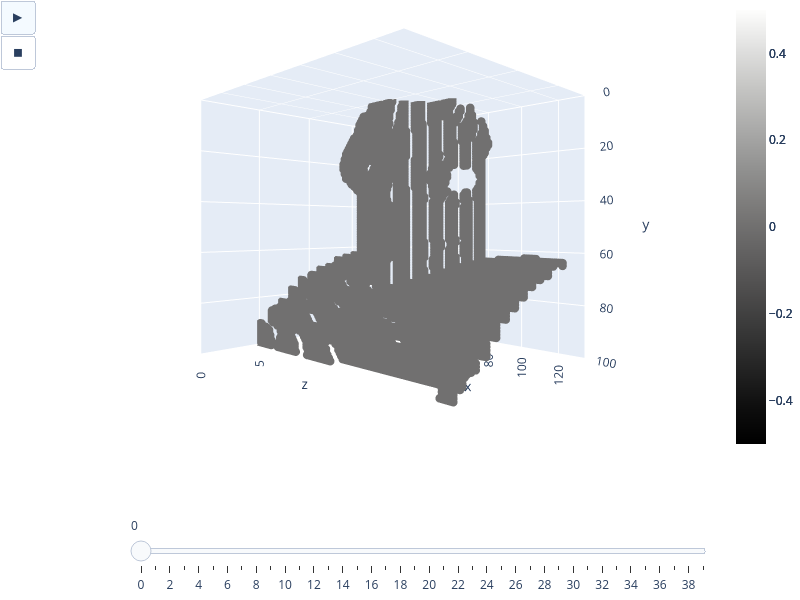

In [23]:
# fig.data has all the code to generate the initial plots
# fig.frames has the code for the frames
# fig.layout the info for the layout
# It would be possible to reuse the dictionaries above to export an animation
# using the fig.to_image + matplotlib animation using imshow
plotly_fig2array(fig)

In [24]:
r, c = ud[...,0].shape

nb_frames = MAX_DEPTH_PATH

fig = go.Figure(frames=[go.Frame(data=go.Surface(
    z=k*np.ones((r, c)),
    surfacecolor=np.flipud(ud[...,k]),
    cmin=ud[...,k].min(), cmax=ud[...,k].max(),
    showscale=False,
    showlegend=False
    ),
    name=str(k) # you need to name the frame for the animation to behave properly
    )
    for k in range(1,nb_frames)])

# Add data to be displayed before animation starts
fig.add_trace(go.Surface(
    z=np.zeros((r, c)),
    surfacecolor=np.flipud(ud[...,0]),
    colorscale='Viridis',
    cmin=0, cmax=1,
    showscale=False,
    showlegend=False
    ))


def frame_args(duration):
    return {
            "frame": {"duration": duration},
            "mode": "immediate",
            "fromcurrent": True,
            "transition": {"duration": duration, "easing": "linear"},
        }

sliders = [
            {
                "pad": {"b": 10, "t": 60},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": [
                    {
                        "args": [[f.name], frame_args(0)],
                        "label": str(k),
                        "method": "animate",
                    }
                    for k, f in enumerate(fig.frames)
                ],
            }
        ]

# Layout
fig.update_layout(
         width=800,
         height=600,
         scene_camera = dict(
                up=dict(x=0, y=1, z=0),
                eye=dict(x=0, y=0, z=-2)
            ),
         scene=dict(xaxis=dict(range=[NEW_SIZE[1],0], autorange=False),
                    yaxis=dict(range=[0,NEW_SIZE[0]], autorange=False),
                    zaxis=dict(range=[-0.1, nb_frames+1], autorange=False),
                    aspectratio=dict(x=1, y=1, z=1),
                    ),
         updatemenus = [
            {
                "buttons": [
                    {
                        "args": [None, frame_args(50)],
                        "label": "&#9654;", # play symbol
                        "method": "animate",
                    },
                    {
                        "args": [[None], frame_args(0)],
                        "label": "&#9724;", # pause symbol
                        "method": "animate",
                    },
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 70},
                "type": "buttons",
                "x": 0.1,
                "y": 0,
            }
         ],
         sliders=sliders
)

fig.show()

In [25]:
fig.write_html("animations/animation_grad.html")